<a href="https://colab.research.google.com/github/kwankoravich/COVID-19-Adverse-Event-Bayesian-Network/blob/main/Covid_19_Vaccine_Pfizer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Clean the data

In [ ]:
!gdown --id 10Dg8Sq1Mr4cTmX_Q4WdkivSq7VmOGJRw

Downloading...
From: https://drive.google.com/uc?id=10Dg8Sq1Mr4cTmX_Q4WdkivSq7VmOGJRw
To: /content/covid-19_vaccine_Pfizer.csv
100% 414k/414k [00:00<00:00, 61.8MB/s]


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('covid-19_vaccine_Pfizer.csv', index_col ="VAERS ID")
df

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,
0920545-1,0920545-1,80+ years,80+,Male,M,ABNORMAL BEHAVIOUR,10061422,Pfizer
0920545-1,0920545-1,80+ years,80+,Male,M,BLOOD PRESSURE ABNORMAL,10005728,Pfizer
0920545-1,0920545-1,80+ years,80+,Male,M,FATIGUE,10016256,Pfizer
0920545-1,0920545-1,80+ years,80+,Male,M,LIMB DISCOMFORT,10061224,Pfizer
0920545-1,0920545-1,80+ years,80+,Male,M,PULSE ABSENT,10037469,Pfizer
...,...,...,...,...,...,...,...,...
1391864-1,1391864-1,40-49 years,40-49,Male,M,COMPUTERISED TOMOGRAM THORAX NORMAL,10057801,Pfizer
1391864-1,1391864-1,40-49 years,40-49,Male,M,DEATH,10011906,Pfizer
1391864-1,1391864-1,40-49 years,40-49,Male,M,ELECTROCARDIOGRAM NORMAL,10014373,Pfizer


In [ ]:
len(df.Symptoms.unique())

1136

Check the VAERS ID and age is uniquely associated in the dataset

In [ ]:
len(set(df['VAERS ID Code']))

904

In [ ]:
df[(df['Age'] == '18-29 years')]

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,
0960841-1,0960841-1,18-29 years,18-29,Male,M,CARDIAC ARREST,10007515,Pfizer
0960841-1,0960841-1,18-29 years,18-29,Male,M,CHEST X-RAY ABNORMAL,10008499,Pfizer
0960841-1,0960841-1,18-29 years,18-29,Male,M,DEATH,10011906,Pfizer
0960841-1,0960841-1,18-29 years,18-29,Male,M,LUNG INFILTRATION,10025102,Pfizer
0960841-1,0960841-1,18-29 years,18-29,Male,M,PYREXIA,10037660,Pfizer
1071935-1,1071935-1,18-29 years,18-29,Male,M,CARDIO-RESPIRATORY ARREST,10007617,Pfizer
1071935-1,1071935-1,18-29 years,18-29,Male,M,DEATH,10011906,Pfizer
1071935-1,1071935-1,18-29 years,18-29,Male,M,DIZZINESS,10013573,Pfizer
1071935-1,1071935-1,18-29 years,18-29,Male,M,FALL,10016173,Pfizer


Grouping the same symptoms

In [ ]:
#df['Symptoms'] = df['Symptoms'].replace(['SARS-COV-2 TEST POSITIVE'], 'COVID-19')
#df['Symptoms'] = df['Symptoms'].replace(['ASTHENIA'], 'FATIGUE')
#df['Symptoms'] = df['Symptoms'].replace(['RESPIRATORY FAILURE'], 'HYPOXIA')
#df['Symptoms'] = df['Symptoms'].replace(['SUDDEN DEATH'], 'DEATH')
#df['Symptoms'] = df['Symptoms'].replace(['DECREASED APPETITE'], 'HYPOPHAGIA')
#df['Symptoms'] = df['Symptoms'].replace(['COVID-19 PNEUMONIA', 'PNEUMONIA ASPIRATION', 'ATYPICAL PNEUMONIA'], 'PNEUMONIA')
#df['Symptoms'] = df['Symptoms'].replace(['PRODUCTIVE COUGH'], 'COUGH')
#df['Symptoms'] = df['Symptoms'].replace(['FEELING ABNORMAL', 'FEELING HOT', 'FEELING COLD', 'MALAISE'], 'ILLNESS')
#df['Symptoms'] = df['Symptoms'].replace(['INTENSIVE CARE', 'INTENSIVE CARE UNIT ACQUIRED WEAKNESS', 'COMA SCALE', 'COMA SCALE ABNORMA'], 'COMA')
#df['Symptoms'] = df['Symptoms'].replace(['VERTIGO'], 'DIZZINESS')

Deleting irrelevant data

In [ ]:
pd.set_option('display.max_rows', df.shape[0]+1)
x = df['Symptoms'].value_counts()
x

DEATH                                                        750
DYSPNOEA                                                     125
SARS-COV-2 TEST POSITIVE                                      78
COVID-19                                                      78
CARDIAC ARREST                                                71
UNRESPONSIVE TO STIMULI                                       70
RESUSCITATION                                                 62
ASTHENIA                                                      58
PNEUMONIA                                                     53
VOMITING                                                      52
FATIGUE                                                       50
PYREXIA                                                       49
CONDITION AGGRAVATED                                          48
COUGH                                                         46
ENDOTRACHEAL INTUBATION                                       43
INTENSIVE CARE           

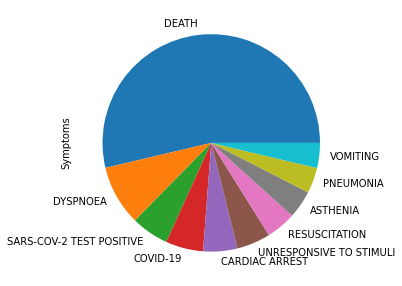

In [ ]:
plot = x[:10].plot.pie(figsize=(5, 5))

In [ ]:
x[:10].index

Index(['DEATH', 'DYSPNOEA', 'SARS-COV-2 TEST POSITIVE', 'COVID-19',
       'CARDIAC ARREST', 'UNRESPONSIVE TO STIMULI', 'RESUSCITATION',
       'ASTHENIA', 'PNEUMONIA', 'VOMITING'],
      dtype='object')

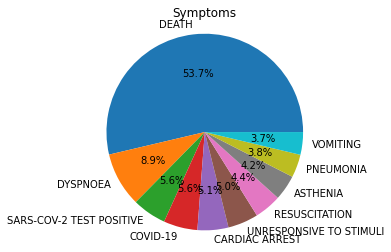

In [ ]:
plt.pie(x[:10],labels=x[:10].index,autopct='%1.1f%%')
plt.title('Symptoms')
plt.axis('equal')
plt.show()

In [ ]:
g = df.groupby(['VAERS ID Code', 'Age'])

In [ ]:
g.count()

,,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID Code,Age,,,,,,
0920545-1,80+ years,6,6,6,6,6,6
0921175-1,65-79 years,2,2,2,2,2,2
0921768-1,50-59 years,11,11,11,11,11,11
0921880-1,80+ years,1,1,1,1,1,1
0924456-1,80+ years,5,5,5,5,5,5
0926269-1,65-79 years,6,6,6,6,6,6
0927189-1,65-79 years,1,1,1,1,1,1
0928062-1,80+ years,15,15,15,15,15,15
0930466-1,80+ years,4,4,4,4,4,4


As we can see the number of row in VAERS_ID is the same number of the groupby (VAERS_ID & Age)

In [ ]:
ID_COVID = df[(df.Symptoms != 'COVID-19')].index.unique()
#ID_COVID = np.array(ID_COVID)
ID_COVID

Index(['0920545-1', '0921175-1', '0921768-1', '0921880-1', '0924456-1',
       '0926269-1', '0927189-1', '0928062-1', '0930466-1', '0932787-1',
       ...
       '1385476-1', '1386585-1', '1387032-1', '1387779-1', '1388373-1',
       '1388903-1', '1389518-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=903)

Exclude COVID-19 Cases by using comparing two array

In [ ]:
ID_death = df[(df.Symptoms == 'DEATH')].index.unique()
#ID_death = np.array(ID_death)
ID_death

Index(['0921768-1', '0921880-1', '0926269-1', '0927189-1', '0928062-1',
       '0932787-1', '0933739-1', '0934059-1', '0934373-1', '0936738-1',
       ...
       '1382701-1', '1385038-1', '1385476-1', '1386585-1', '1387032-1',
       '1388373-1', '1388903-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=750)

In [ ]:
death_covid = ID_COVID.intersection(ID_death)
death_covid

Index(['0921768-1', '0921880-1', '0926269-1', '0927189-1', '0928062-1',
       '0932787-1', '0933739-1', '0934059-1', '0934373-1', '0936738-1',
       ...
       '1382701-1', '1385038-1', '1385476-1', '1386585-1', '1387032-1',
       '1388373-1', '1388903-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=750)

In [ ]:
death_uncovid = ID_COVID[ID_COVID.isin(ID_death) == False]
death_uncovid

Index(['0920545-1', '0921175-1', '0924456-1', '0930466-1', '0934507-1',
       '0938118-1', '0939845-1', '0942085-1', '0945603-1', '0946959-1',
       ...
       '1357346-1', '1357369-1', '1365222-1', '1368008-1', '1374169-1',
       '1378531-1', '1382468-1', '1385337-1', '1387779-1', '1389518-1'],
      dtype='object', name='VAERS ID', length=153)

In [ ]:
uncovid_death = ID_death[ID_death.isin(ID_COVID) == False]
uncovid_death

Index([], dtype='object', name='VAERS ID')

In [ ]:
df[df['VAERS ID Code'] == '0921175-1']

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,
0921175-1,0921175-1,65-79 years,65-79,Female,F,BODY TEMPERATURE INCREASED,10005911,Pfizer
0921175-1,0921175-1,65-79 years,65-79,Female,F,DYSPNOEA,10013968,Pfizer


In [ ]:
#ID_death = df_COVID[(df_COVID.Symptoms == 'DEATH')].index.unique()
#ID_death

In [ ]:
#df_death_covid = df_COVID[df_COVID['VAERS ID Code'].isin(ID_death)].Symptoms
#df_death_covid

Find max symptoms in death cases

In [ ]:
symp_len = {} # store the length of symptom in case of DEATH
for i in range(len(ID_death)):
  sum = 0
  x = ID_death[i]
  symp_len[x] = len(df[(df['VAERS ID Code'] == x)].Symptoms)
print(symp_len)

{'0921768-1': 11, '0921880-1': 1, '0926269-1': 6, '0927189-1': 1, '0928062-1': 15, '0932787-1': 1, '0933739-1': 11, '0934059-1': 2, '0934373-1': 3, '0936738-1': 21, '0937444-1': 2, '0938974-1': 7, '0941215-1': 2, '0942072-1': 4, '0942290-1': 15, '0943266-1': 9, '0944282-1': 2, '0944595-1': 6, '0944998-1': 5, '0946225-1': 4, '0948150-1': 11, '0948228-1': 1, '0949657-1': 3, '0950441-1': 56, '0952799-1': 3, '0953590-1': 2, '0953754-1': 2, '0953865-1': 5, '0955597-1': 1, '0956761-1': 2, '0956843-1': 1, '0959179-1': 34, '0959929-1': 21, '0960552-1': 2, '0960841-1': 5, '0961434-1': 7, '0961776-1': 3, '0962325-1': 7, '0962390-1': 4, '0962784-1': 3, '0962827-1': 7, '0962966-1': 6, '0963057-1': 13, '0964617-1': 1, '0967743-1': 1, '0968846-1': 4, '0969220-1': 1, '0970976-1': 8, '0972092-1': 1, '0972782-1': 2, '0974172-1': 1, '0974489-1': 1, '0974855-1': 4, '0975184-1': 2, '0975382-1': 13, '0975434-1': 15, '0975744-1': 10, '0975952-1': 1, '0977963-1': 2, '0978754-1': 1, '0979255-1': 29, '0979818-

In [ ]:
def max_symp(dict):
  max_value = 0
  max_value = max(dict.values())
  for i, j in dict.items():
    if j == max_value:
      return i
      break
max_symp(symp_len)

'1019670-1'

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len)].Symptoms.unique()

array(['ALANINE AMINOTRANSFERASE INCREASED', 'ANION GAP',
       'ASPARTATE AMINOTRANSFERASE INCREASED', 'ASTHENIA',
       'BACTERIAL TEST POSITIVE', 'BASE EXCESS',
       'BASOPHIL COUNT INCREASED', 'BILIRUBIN URINE',
       'BLOOD ALBUMIN DECREASED', 'BLOOD ALKALINE PHOSPHATASE INCREASED',
       'BLOOD BICARBONATE INCREASED', 'BLOOD BILIRUBIN NORMAL',
       'BLOOD CALCIUM DECREASED', 'BLOOD CHLORIDE DECREASED',
       'BLOOD CREATINE PHOSPHOKINASE MB DECREASED',
       'BLOOD CREATINE PHOSPHOKINASE NORMAL',
       'BLOOD CREATININE INCREASED', 'BLOOD GLUCOSE INCREASED',
       'BLOOD LACTIC ACID NORMAL', 'BLOOD PH DECREASED',
       'BLOOD POTASSIUM NORMAL', 'BLOOD SODIUM DECREASED',
       'BLOOD SODIUM NORMAL', 'BLOOD UREA INCREASED',
       'BLOOD UREA NITROGEN/CREATININE RATIO INCREASED',
       'C-REACTIVE PROTEIN NORMAL', 'CARBON DIOXIDE DECREASED',
       'CARDIAC ARREST', 'CHEST X-RAY ABNORMAL', 'CHROMATURIA',
       'CREATINE URINE INCREASED', 'CRYSTAL URINE PRESENT', 'DE

Find max symptoms of undeath cases

In [ ]:
ID_before_alive = df[(df.Symptoms != 'DEATH')].index.unique()
#ID_death = np.array(ID_death)
ID_before_alive

Index(['0920545-1', '0921175-1', '0921768-1', '0924456-1', '0926269-1',
       '0928062-1', '0930466-1', '0933739-1', '0934059-1', '0934373-1',
       ...
       '1385337-1', '1386585-1', '1387032-1', '1387779-1', '1388373-1',
       '1388903-1', '1389518-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=672)

In [ ]:
ID_alive = ID_before_alive[ID_before_alive.isin(ID_death) == False]
ID_alive

Index(['0920545-1', '0921175-1', '0924456-1', '0930466-1', '0934507-1',
       '0938118-1', '0939845-1', '0942085-1', '0945603-1', '0946959-1',
       ...
       '1357369-1', '1365222-1', '1368008-1', '1374169-1', '1378531-1',
       '1382347-1', '1382468-1', '1385337-1', '1387779-1', '1389518-1'],
      dtype='object', name='VAERS ID', length=154)

In [ ]:
symp_len_alive = {} # store the length of symptom in case of DEATH
for i in range(len(ID_alive)):
  sum = 0
  y = ID_alive[i]
  symp_len_alive[y] = len(df[(df['VAERS ID Code'] == y)].Symptoms)
print(symp_len_alive)

{'0920545-1': 6, '0921175-1': 2, '0924456-1': 5, '0930466-1': 4, '0934507-1': 1, '0938118-1': 12, '0939845-1': 2, '0942085-1': 6, '0945603-1': 4, '0946959-1': 2, '0953183-1': 3, '0954812-1': 8, '0958322-1': 2, '0959079-1': 8, '0961010-1': 4, '0966178-1': 1, '0969488-1': 7, '0970618-1': 2, '0971736-1': 2, '0971969-1': 1, '0978199-1': 2, '0979101-1': 1, '0983169-1': 3, '0983173-1': 7, '0983184-1': 6, '0983187-1': 7, '0983189-1': 5, '0983192-1': 8, '0983193-1': 9, '0986869-1': 1, '0987636-1': 7, '0995520-1': 10, '0997571-1': 1, '0998637-1': 5, '1000739-1': 10, '1002057-1': 1, '1008758-1': 6, '1011677-1': 16, '1011905-1': 5, '1012703-1': 32, '1017744-1': 1, '1020443-1': 11, '1024343-1': 1, '1035539-1': 6, '1035546-1': 3, '1035850-1': 7, '1037865-1': 4, '1042012-1': 1, '1043690-1': 2, '1047351-1': 18, '1048688-1': 2, '1052217-1': 5, '1054434-1': 2, '1058464-1': 2, '1058963-1': 2, '1059356-1': 5, '1063674-1': 1, '1065435-1': 4, '1068308-1': 11, '1075298-1': 13, '1077297-1': 3, '1080404-1': 1

In [ ]:
def max_symp(dict):
  max_value = 0
  max_value = max(dict.values())
  for i, j in dict.items():
    if j == max_value:
      return i
      break
max_symp(symp_len_alive)

'1134398-1'

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

array(['ALANINE AMINOTRANSFERASE INCREASED', 'ANGIOCARDIOGRAM',
       'ASPARTATE AMINOTRANSFERASE INCREASED', 'ATRIAL FIBRILLATION',
       'BLADDER CATHETERISATION', 'BLOOD ALBUMIN NORMAL',
       'BLOOD BICARBONATE', 'BLOOD CHLORIDE NORMAL',
       'BLOOD CREATINE PHOSPHOKINASE INCREASED',
       'BLOOD CREATININE NORMAL', 'BLOOD GLUCOSE INCREASED',
       'BLOOD LACTIC ACID', 'BLOOD MAGNESIUM INCREASED',
       'BLOOD PH DECREASED', 'BLOOD POTASSIUM DECREASED',
       'BLOOD SODIUM NORMAL', 'BLOOD UREA NORMAL', 'BLOOD URINE PRESENT',
       'BRAIN STEM ISCHAEMIA', 'BUNDLE BRANCH BLOCK RIGHT',
       'CARDIAC ARREST', 'CARDIAC VENTRICULOGRAM',
       'CATHETERISATION CARDIAC', 'CATHETERISATION CARDIAC ABNORMAL',
       'CEREBRAL ARTERY EMBOLISM', 'CHEST X-RAY ABNORMAL', 'CYANOSIS',
       'EJECTION FRACTION DECREASED', 'ELECTROCARDIOGRAM ABNORMAL',
       'ELECTROENCEPHALOGRAM ABNORMAL', 'ENCEPHALOPATHY',
       'GAIT DISTURBANCE', 'GLIOSIS',
       'GLOMERULAR FILTRATION RATE DECRE

In [ ]:
df[df['VAERS ID Code'] == '0926269-1'].Symptoms.unique()

array(['CARDIOVERSION', 'DEATH', 'PULSE ABSENT', 'RESPIRATORY ARREST',
       'RESUSCITATION', 'UNRESPONSIVE TO STIMULI'], dtype=object)

# Ranking the occurence of symptom

In [ ]:
len(df['Symptoms'].unique())

1136

In [ ]:
df_symptom = df['Symptoms']
df_symptom.value_counts().head(5)

DEATH                       750
DYSPNOEA                    125
SARS-COV-2 TEST POSITIVE     78
COVID-19                     78
CARDIAC ARREST               71
Name: Symptoms, dtype: int64

In [ ]:
df_symptom_top5 = df_symptom.value_counts().head(5)
df_symptom_top20 = df_symptom.value_counts().head(20)
print(df_symptom_top5.index)

Index(['DEATH', 'DYSPNOEA', 'SARS-COV-2 TEST POSITIVE', 'COVID-19',
       'CARDIAC ARREST'],
      dtype='object')


In [ ]:
for i in df_symptom:
  arr = []
  for j in range(len(df_symptom)):
    if df_symptom[j] == i:
      arr.append(1)
    else:
      arr.append(0)
  df[i] = arr
df

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0920545-1,0920545-1,80+ years,80+,Male,M,ABNORMAL BEHAVIOUR,10061422,Pfizer,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0920545-1,0920545-1,80+ years,80+,Male,M,BLOOD PRESSURE ABNORMAL,10005728,Pfizer,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0920545-1,0920545-1,80+ years,80+,Male,M,FATIGUE,10016256,Pfizer,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0920545-1,0920545-1,80+ years,80+,Male,M,LIMB DISCOMFORT,10061224,Pfizer,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0920545-1,0920545-1,80+ years,80+,Male,M,PULSE ABSENT,10037469,Pfizer,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0920545-1,0920545-1,80+ years,80+,Male,M,RESPIRATORY ARREST,10038669,Pfizer,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,0921175-1,65-79 years,65-79,Female,F,BODY TEMPERATURE INCREASED,10005911,Pfizer,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,0921175-1,65-79 years,65-79,Female,F,DYSPNOEA,10013968,Pfizer,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,CARDIAC ARREST,10007515,Pfizer,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df[df['VAERS ID Code']=='0921768-1']

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0921768-1,0921768-1,50-59 years,50-59,Female,F,CARDIAC ARREST,10007515,Pfizer,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,DEATH,10011906,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,DIZZINESS,10013573,Pfizer,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,DYSPNOEA,10013968,Pfizer,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,FATIGUE,10016256,Pfizer,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,FEELING HOT,10016334,Pfizer,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,HOT FLUSH,10060800,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,LETHARGY,10024264,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,NAUSEA,10028813,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_undrup = df.drop_duplicates(subset=['VAERS ID Code'], keep='first')
df_undrup

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0920545-1,0920545-1,80+ years,80+,Male,M,ABNORMAL BEHAVIOUR,10061422,Pfizer,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,0921175-1,65-79 years,65-79,Female,F,BODY TEMPERATURE INCREASED,10005911,Pfizer,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,CARDIAC ARREST,10007515,Pfizer,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921880-1,0921880-1,80+ years,80+,Male,M,DEATH,10011906,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924456-1,0924456-1,80+ years,80+,Female,F,PUPIL FIXED,10037515,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926269-1,0926269-1,65-79 years,65-79,Male,M,CARDIOVERSION,10007661,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0927189-1,0927189-1,65-79 years,65-79,Male,M,DEATH,10011906,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928062-1,0928062-1,80+ years,80+,Male,M,BLOOD LACTIC ACID INCREASED,10005635,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930466-1,0930466-1,80+ years,80+,Female,F,CHEST PAIN,10008479,Pfizer,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
col = df.columns
col = np.array(col)
col
symtomps = col[8:]
symtomps

array(['ABNORMAL BEHAVIOUR', 'BLOOD PRESSURE ABNORMAL', 'FATIGUE', ...,
       'DISTURBANCE IN ATTENTION', "PARKINSON'S DISEASE",
       'ULTRASOUND SCAN'], dtype=object)

In [ ]:
df.index.unique()

Index(['0920545-1', '0921175-1', '0921768-1', '0921880-1', '0924456-1',
       '0926269-1', '0927189-1', '0928062-1', '0930466-1', '0932787-1',
       ...
       '1385476-1', '1386585-1', '1387032-1', '1387779-1', '1388373-1',
       '1388903-1', '1389518-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=904)

In [ ]:
for i in df.index.unique():
  x = 0
  for j in symtomps: 
    x = 0
    x = df.loc[i,j].sum() #sum the value in the same ID for each symptoms
    #print(x)
    df_undrup.loc[i,j] = x
df_undrup

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0920545-1,0920545-1,80+ years,80+,Male,M,ABNORMAL BEHAVIOUR,10061422,Pfizer,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,0921175-1,65-79 years,65-79,Female,F,BODY TEMPERATURE INCREASED,10005911,Pfizer,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,0921768-1,50-59 years,50-59,Female,F,CARDIAC ARREST,10007515,Pfizer,0,0,1,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921880-1,0921880-1,80+ years,80+,Male,M,DEATH,10011906,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924456-1,0924456-1,80+ years,80+,Female,F,PUPIL FIXED,10037515,Pfizer,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926269-1,0926269-1,65-79 years,65-79,Male,M,CARDIOVERSION,10007661,Pfizer,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0927189-1,0927189-1,65-79 years,65-79,Male,M,DEATH,10011906,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928062-1,0928062-1,80+ years,80+,Male,M,BLOOD LACTIC ACID INCREASED,10005635,Pfizer,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930466-1,0930466-1,80+ years,80+,Female,F,CHEST PAIN,10008479,Pfizer,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_undrup[(df_undrup['COVID-19']==0) & (df_undrup['DEATH']==1)].index.unique()

Index(['0921768-1', '0921880-1', '0926269-1', '0927189-1', '0928062-1',
       '0932787-1', '0933739-1', '0934059-1', '0934373-1', '0936738-1',
       ...
       '1382701-1', '1385038-1', '1385476-1', '1386585-1', '1387032-1',
       '1388373-1', '1388903-1', '1389545-1', '1389554-1', '1391864-1'],
      dtype='object', name='VAERS ID', length=690)

In [ ]:
df_undrup_final = df_undrup.drop(columns=['VAERS ID Code', 'Age Code','Sex Code', 'Symptoms','Symptoms Code'])
df_undrup_final

,Age,Sex,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,PULMONARY IMAGING PROCEDURE ABNORMAL,TROPONIN,VOMITING,CHEST PAIN,MYOCARDIAL INFARCTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0920545-1,80+ years,Male,Pfizer,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,65-79 years,Female,Pfizer,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,50-59 years,Female,Pfizer,0,0,1,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921880-1,80+ years,Male,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924456-1,80+ years,Female,Pfizer,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926269-1,65-79 years,Male,Pfizer,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0927189-1,65-79 years,Male,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928062-1,80+ years,Male,Pfizer,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930466-1,80+ years,Female,Pfizer,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
#rows = np.random.choice(df_undrup_final[df_undrup_final['DEATH'] == 1].index, 77)
#df_undrup_final_death = df_undrup_final.loc[rows]
#df_undrup_final_death

In [ ]:
#rows = np.random.choice(df_undrup_final[df_undrup_final['DEATH'] == 0].index, 77)
#df_undrup_final_live = df_undrup_final.loc[rows]
#df_undrup_final_live

In [ ]:
#df_undrup_final = pd.concat([df_undrup_final_live, df_undrup_final_death])
#df_undrup_final = df_undrup_final.iloc[np.random.permutation(len(df_undrup_final))]
#df_undrup_final

#Model Training

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz

In [ ]:
# Train Test Split
X_train, X_test, y_train, y_test = train_test_split(df_undrup_final.loc[:, 'DYSPNOEA':'PNEUMONIA'], df_undrup_final[['DEATH']], test_size=0.2, random_state=101)

In [ ]:
dt = DecisionTreeClassifier()
clf_dt=dt.fit(X_train, y_train)

In [ ]:
clf_dt.score(X_test, y_test)

1.0

#Bayesian model

In [ ]:
from scipy import stats
import arviz as az
import numpy as np
import matplotlib.pyplot as plt
import pymc3 as pm
import seaborn as sns
import pandas as pd
from theano import shared
from sklearn import preprocessing

In [ ]:
with pm.Model() as model_g:
    μ = pm.Uniform('μ', lower=0, upper=1)
    σ = pm.HalfNormal('σ', sd=1)
    y = pm.Normal('y', mu=μ, sd=σ, observed=df_undrup_final['DEATH'].values)
    trace_g = pm.sample(1000, tune=1000)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  """
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [σ, μ]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 2 seconds.


/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7feffb2cdf50>,
      dtype=object)

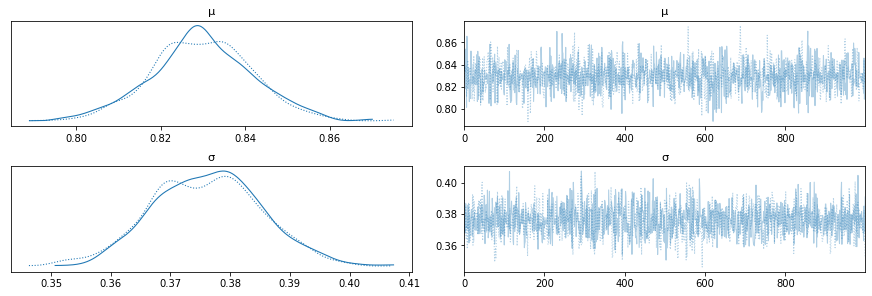

In [ ]:
az.plot_trace(trace_g)

/usr/local/lib/python3.7/dist-packages/arviz/plots/jointplot.py:144: UserWarning: plot_joint will be deprecated. Please use plot_pair instead.
  warnings.warn("plot_joint will be deprecated. Please use plot_pair instead.")
/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/arviz/utils.py:409: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_cov" failed type inference due to: Untyped global name '_dot': cannot determine Numba type of <class 'arviz.utils.maybe_numba_fn'>

File "../usr/local/lib/python3.7/dist-packages/arviz/utils.py", line 421:
def _cov(data):
    <source elided>
        x -= avg[:, None]
        prod = _dot(x

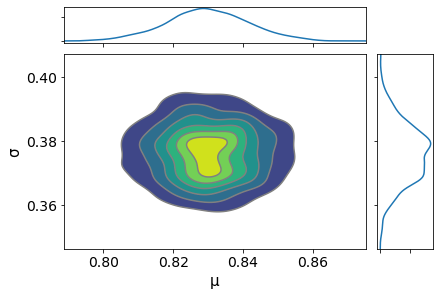

In [ ]:
az.plot_joint(trace_g, kind='kde', fill_last=False);

In [ ]:
az.summary(trace_g)

/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ,0.830,0.012,0.807,0.853,0.0,0.0,1669.0,1469.0,1.0
σ,0.376,0.009,0.360,0.394,0.0,0.0,1723.0,1384.0,1.0


/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7feffe59bcd0>,
      dtype=object)

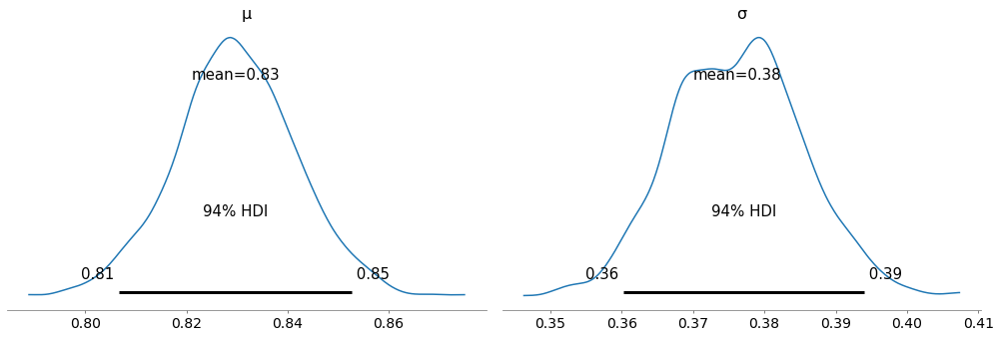

In [ ]:
az.plot_posterior(trace_g)

In [ ]:
ppc = pm.sample_posterior_predictive(trace_g, samples=1000, model=model_g)
np.asarray(ppc['y']).shape

/usr/local/lib/python3.7/dist-packages/pymc3/sampling.py:1690: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  "samples parameter is smaller than nchains times ndraws, some draws "


(1000, 904)

[Text(0, 0.5, 'Frequency'),
 Text(0.5, 0, 'mean(x)'),
 Text(0.5, 1.0, 'Posterior predictive of the mean')]

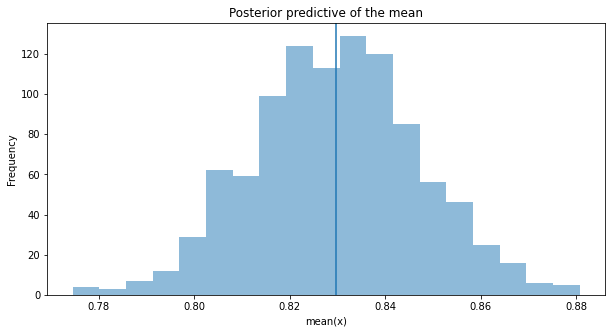

In [ ]:
_, ax = plt.subplots(figsize=(10, 5))
ax.hist([y.mean() for y in ppc['y']], bins=19, alpha=0.5)
ax.axvline(df_undrup_final['DEATH'].mean())
ax.set(title='Posterior predictive of the mean', xlabel='mean(x)', ylabel='Frequency')

#Bayesian Network

In [ ]:
pip install pybbn

  Created wheel for pybbn: filename=pybbn-3.2.1-py3-none-any.whl size=39726 sha256=14d9e738d549dfde8297acadddfd13364c5381e99c79d1588d43ee7e6e6cf781
  Stored in directory: /root/.cache/pip/wheels/a8/64/55/b52530d41fe7c9ae501ddd7c06f3122ceb5f15921680f0371b
Successfully built pybbn


In [ ]:
import networkx as nx # for drawing graphs

# for creating Bayesian Belief Networks (BBN)
from pybbn.graph.dag import Bbn
from pybbn.graph.edge import Edge, EdgeType
from pybbn.graph.jointree import EvidenceBuilder
from pybbn.graph.node import BbnNode
from pybbn.graph.variable import Variable
from pybbn.pptc.inferencecontroller import InferenceController

In [ ]:
# This function helps to calculate probability distribution, which goes into BBN (note, can handle up to 2 parents)
def probs(data, child, parent1=None, parent2=None):
    # Initialize empty list
    prob=[]
    if parent1==None:
        # Calculate probabilities
        prob=data[child].value_counts(normalize=True, sort=False).sort_index().tolist()
    elif parent1!=None:
            # Check if child node has 1 parent or 2 parents
            if parent2==None:
                # Work out the bands present in the parent variable
                bands=data[parent1].value_counts(sort=False).sort_index().index.tolist()
                # Caclucate probabilities
                for val in bands:
                    temp=data[data[parent1]==val][child].value_counts(normalize=True).sort_index().tolist()
                    prob=prob+temp
            else:    
                # Work out the bands present in the parent variable
                bands1=data[parent1].value_counts(sort=False).sort_index().index.tolist()
                bands2=data[parent2].value_counts(sort=False).sort_index().index.tolist()
                # Caclucate probabilities
                for val1 in bands1:
                    for val2 in bands2:
                        #print(val1)
                        #print(val2)
                        temp=data[(data[parent1]==val1) & (data[parent2]==val2)][child].value_counts(normalize=True).sort_index().tolist()
                        prob=prob+temp
    else: print("Error in Probability Frequency Calculations")
    
    if (child != None) & (parent1 == None) & (parent2 == None):
      i = len(prob)
      while i != len(data[child].unique()):
        prob.extend([0])
        i+=1
    
    if (parent1 != None) & (parent2 == None):
      i = len(prob)
      while i != len(data[child].unique()) * len(data[parent1].unique()): 
        prob.extend([0]) 
        i+=1

    if (parent1 != None) & (parent2 != None):
      i = len(prob)
      while i != len(data[child].unique()) * len(data[parent1].unique()) * len(data[parent2].unique()):
        prob.extend([0])
        i+=1
    return prob  

In [ ]:
df_undrup_final

,Age,Sex,Vaccine Manufacturer,ABNORMAL BEHAVIOUR,BLOOD PRESSURE ABNORMAL,FATIGUE,LIMB DISCOMFORT,PULSE ABSENT,RESPIRATORY ARREST,BODY TEMPERATURE INCREASED,DYSPNOEA,CARDIAC ARREST,DEATH,DIZZINESS,FEELING HOT,HOT FLUSH,LETHARGY,NAUSEA,RESPIRATORY RATE DECREASED,SYNCOPE,PUPIL FIXED,REGURGITATION,SARS-COV-2 TEST POSITIVE,UNRESPONSIVE TO STIMULI,CARDIOVERSION,RESUSCITATION,BLOOD LACTIC ACID INCREASED,ENDOTRACHEAL INTUBATION,HYPOTENSION,HYPOXIA,LABORATORY TEST,LIVER FUNCTION TEST,LUNG INFILTRATION,PANCYTOPENIA,PULMONARY CONGESTION,PULMONARY IMAGING PROCEDURE ABNORMAL,TROPONIN,VOMITING,CHEST PAIN,MYOCARDIAL INFARCTION,...,PANCREATIC CARCINOMA,BLOOD CORTISOL,GENERALISED TONIC-CLONIC SEIZURE,INJURY,BLOOD BICARBONATE NORMAL,BRONCHIAL WALL THICKENING,BRONCHITIS,HAEMODIALYSIS,LABILE BLOOD PRESSURE,TRANSCUTANEOUS PACING,WHEELCHAIR USER,BLOOD LACTATE DEHYDROGENASE,BLOOD MAGNESIUM,BLOOD PHOSPHORUS,C-REACTIVE PROTEIN,GRAM STAIN,SERUM FERRITIN,SUSPECTED COVID-19,ADAMTS13 ACTIVITY NORMAL,CARCINOEMBRYONIC ANTIGEN INCREASED,VASODILATATION,LUNG ASSIST DEVICE THERAPY,VENTRICULAR ASSIST DEVICE INSERTION,HYPOOSMOLAR STATE,TRACHEAL HAEMORRHAGE,INTRACRANIAL MASS,BLOOD ELECTROLYTES NORMAL,PULMONARY AIR LEAKAGE,DELIVERY,MYOCARDITIS,BRAIN COMPRESSION,INTRAVENTRICULAR HAEMORRHAGE,CARDIAC ASSISTANCE DEVICE USER,BLOOD FIBRINOGEN,CULTURE URINE POSITIVE,ELECTROCARDIOGRAM T WAVE ABNORMAL,URINARY TRACT INFECTION FUNGAL,DISTURBANCE IN ATTENTION,PARKINSON'S DISEASE,ULTRASOUND SCAN
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0920545-1,80+ years,Male,Pfizer,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921175-1,65-79 years,Female,Pfizer,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921768-1,50-59 years,Female,Pfizer,0,0,1,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921880-1,80+ years,Male,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924456-1,80+ years,Female,Pfizer,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926269-1,65-79 years,Male,Pfizer,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0927189-1,65-79 years,Male,Pfizer,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928062-1,80+ years,Male,Pfizer,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930466-1,80+ years,Female,Pfizer,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_undrup_final.Age.unique()

array(['80+ years', '65-79 years', '50-59 years', '60-64 years',
       '18-29 years', '40-49 years', '30-39 years'], dtype=object)

In [ ]:
df_undrup_final.Age.value_counts()

80+ years      390
65-79 years    344
50-59 years     65
60-64 years     52
40-49 years     24
30-39 years     19
18-29 years     10
Name: Age, dtype: int64

In [ ]:
#df_undrup_final['Age'] = df_undrup_final['Age'].replace(['65-79 years', '60-64 years', '80+ years'],'60+ years')
#df_undrup_final['Age'] = df_undrup_final['Age'].replace(['18-29 years', '30-39 years', '50-59 years', '40-49 years'],'18-59 years')
#df_undrup_final.Age.value_counts()

In [ ]:
probs(df_undrup_final, child='COVID-19')

[0.9137168141592921, 0.08628318584070796]

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

array(['ALANINE AMINOTRANSFERASE INCREASED', 'ANGIOCARDIOGRAM',
       'ASPARTATE AMINOTRANSFERASE INCREASED', 'ATRIAL FIBRILLATION',
       'BLADDER CATHETERISATION', 'BLOOD ALBUMIN NORMAL',
       'BLOOD BICARBONATE', 'BLOOD CHLORIDE NORMAL',
       'BLOOD CREATINE PHOSPHOKINASE INCREASED',
       'BLOOD CREATININE NORMAL', 'BLOOD GLUCOSE INCREASED',
       'BLOOD LACTIC ACID', 'BLOOD MAGNESIUM INCREASED',
       'BLOOD PH DECREASED', 'BLOOD POTASSIUM DECREASED',
       'BLOOD SODIUM NORMAL', 'BLOOD UREA NORMAL', 'BLOOD URINE PRESENT',
       'BRAIN STEM ISCHAEMIA', 'BUNDLE BRANCH BLOCK RIGHT',
       'CARDIAC ARREST', 'CARDIAC VENTRICULOGRAM',
       'CATHETERISATION CARDIAC', 'CATHETERISATION CARDIAC ABNORMAL',
       'CEREBRAL ARTERY EMBOLISM', 'CHEST X-RAY ABNORMAL', 'CYANOSIS',
       'EJECTION FRACTION DECREASED', 'ELECTROCARDIOGRAM ABNORMAL',
       'ELECTROENCEPHALOGRAM ABNORMAL', 'ENCEPHALOPATHY',
       'GAIT DISTURBANCE', 'GLIOSIS',
       'GLOMERULAR FILTRATION RATE DECRE

In [ ]:
# Create nodes by using our earlier function to automatically calculate probabilities
AGE = BbnNode(Variable(0, 'AGE', df_undrup_final.Age.unique()), probs(df_undrup_final, child = 'Age'))
DY = BbnNode(Variable(1, 'DYSPNOEA', df_undrup_final['DYSPNOEA'].map(str).unique()), probs(df_undrup_final, child='DYSPNOEA', parent1= 'PNEUMONIA'))
PN = BbnNode(Variable(2, 'PNEUMONIA', df_undrup_final['PNEUMONIA'].map(str).unique()), probs(df_undrup_final, child='PNEUMONIA', parent1='COVID-19'))
DT = BbnNode(Variable(3, 'DEATH', df_undrup_final['DEATH'].map(str).unique()), probs(df_undrup_final, child='DEATH', parent1='DYSPNOEA', parent2 = 'CARDIAC ARREST'))
SEX = BbnNode(Variable(4, 'SEX', df_undrup_final.Sex.unique()), probs(df_undrup_final, child = 'Sex'))
COV = BbnNode(Variable(5, 'COVID-19', df_undrup_final['COVID-19'].map(str).unique()), probs(df_undrup_final, child = 'COVID-19', parent1='Sex', parent2='Age'))
COMA = BbnNode(Variable(6, 'COMA', df_undrup_final['COMA'].map(str).unique()), probs(df_undrup_final, child = 'COMA', parent1='UNRESPONSIVE TO STIMULI'))
CA = BbnNode(Variable(7, 'CARDIAC ARREST', df_undrup_final['CARDIAC ARREST'].map(str).unique()), probs(df_undrup_final, child = 'CARDIAC ARREST', parent1='COMA', parent2='RESUSCITATION'))
RES = BbnNode(Variable(8, 'RESUSCITATION', df_undrup_final['RESUSCITATION'].map(str).unique()), probs(df_undrup_final, child = 'RESUSCITATION'))
UNRES = BbnNode(Variable(9, 'UNRESPONSIVE TO STIMULI', df_undrup_final['UNRESPONSIVE TO STIMULI'].map(str).unique()), probs(df_undrup_final, child = 'UNRESPONSIVE TO STIMULI'))


# Create Network
bbn = Bbn() \
    .add_node(AGE) \
    .add_node(SEX) \
    .add_node(COV) \
    .add_node(COMA) \
    .add_node(RES) \
    .add_node(UNRES) \
    .add_node(PN) \
    .add_node(DY) \
    .add_node(CA) \
    .add_node(DT) \
    .add_edge(Edge(SEX, COV, EdgeType.DIRECTED)) \
    .add_edge(Edge(AGE, COV, EdgeType.DIRECTED)) \
    .add_edge(Edge(UNRES, COMA, EdgeType.DIRECTED)) \
    .add_edge(Edge(COMA, CA, EdgeType.DIRECTED)) \
    .add_edge(Edge(RES, CA, EdgeType.DIRECTED)) \
    .add_edge(Edge(COV, PN, EdgeType.DIRECTED)) \
    .add_edge(Edge(PN, DY, EdgeType.DIRECTED))\
    .add_edge(Edge(CA, DT, EdgeType.DIRECTED))\
    .add_edge(Edge(DY, DT, EdgeType.DIRECTED))

# Convert the BBN to a join tree
join_tree = InferenceController.apply(bbn)

In [ ]:
# Set node positions
#pos = {0: (-1, 2), 1: (-1, 0.5), 2: (1, 0.5), 3: (0, -1), 4:(1,1)}

# Set options for graph looks
#options = {
#    "font_size": 12,
#    "node_size": 4000,
#    "node_color": "white",
#    "edgecolors": "black",
#    "edge_color": "red",
#   "linewidths": 5,
#    "width": 5,}
    
# Generate graph
#n, d = bbn.to_nx_graph()
#nx.draw(n, with_labels=True, labels=d, pos=pos, **options)

# Update margins and print the graph
#ax = plt.gca()
#ax.margins(0.10)
#plt.axis("off")
#plt.show()

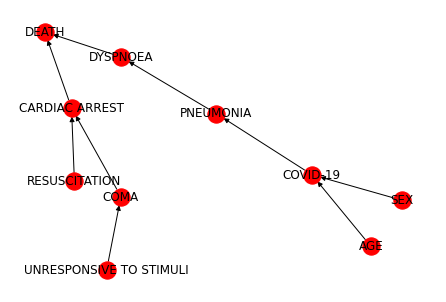

In [ ]:
import networkx as nx
n, d = bbn.to_nx_graph()
nx.draw(n, with_labels=True, labels=d, node_color='r', alpha=1.0)

In [ ]:
# Define a function for printing marginal probabilities
def print_probs():
    for node in join_tree.get_bbn_nodes():
        potential = join_tree.get_bbn_potential(node)
        print("Node:", node)
        print("Values:")
        print(potential)
        print('----------------')
        
# Use the above function to print marginal probabilities
print_probs()

Node: 6|COMA|0,1
Values:
6=0|0.99691
6=1|0.00309
----------------
Node: 9|UNRESPONSIVE TO STIMULI|0,1
Values:
9=0|0.92255
9=1|0.07745
----------------
Node: 1|DYSPNOEA|0,1
Values:
1=0|0.85970
1=1|0.14030
----------------
Node: 7|CARDIAC ARREST|0,1
Values:
7=0|0.92152
7=1|0.07848
----------------
Node: 3|DEATH|0,1
Values:
3=0|0.16999
3=1|0.83001
----------------
Node: 8|RESUSCITATION|0,1
Values:
8=0|0.93163
8=1|0.06837
----------------
Node: 2|PNEUMONIA|0,1
Values:
2=0|0.93192
2=1|0.06808
----------------
Node: 5|COVID-19|0,1
Values:
5=0|0.82297
5=1|0.17703
----------------
Node: 4|SEX|Male,Female
Values:
4=Male|0.44372
4=Female|0.55628
----------------
Node: 0|AGE|80+ years,65-79 years,50-59 years,60-64 years,18-29 years,40-49 years,30-39 years
Values:
0=80+ years|0.03777
0=65-79 years|0.03605
0=50-59 years|0.04754
0=60-64 years|0.12389
0=18-29 years|0.09911
0=40-49 years|0.65565
0=30-39 years|0.00000
----------------


In [ ]:
# print the posterior probabilities
for node, posteriors in join_tree.get_posteriors().items():
 p = ', '.join([f'{val}={prob:.5f}' for val, prob in posteriors.items()])
 print(f'{node} : {p}')

COMA : 0=0.99691, 1=0.00309
UNRESPONSIVE TO STIMULI : 0=0.92255, 1=0.07745
DYSPNOEA : 0=0.85970, 1=0.14030
CARDIAC ARREST : 0=0.92152, 1=0.07848
DEATH : 0=0.16999, 1=0.83001
RESUSCITATION : 0=0.93163, 1=0.06837
PNEUMONIA : 0=0.93192, 1=0.06808
COVID-19 : 0=0.82297, 1=0.17703
SEX : Male=0.44372, Female=0.55628
AGE : 80+ years=0.03777, 65-79 years=0.03605, 50-59 years=0.04754, 60-64 years=0.12389, 18-29 years=0.09911, 40-49 years=0.65565, 30-39 years=0.00000


#Prediction

In [ ]:
# To add evidence of events that happened so probability distribution can be recalculated
def evidence(ev, nod, cat, val):
    ev = EvidenceBuilder() \
    .with_node(join_tree.get_bbn_node_by_name(nod)) \
    .with_evidence(cat, val) \
    .build()
    join_tree.set_observation(ev)
    
# Use above function to add evidence
evidence('ev1','SEX','Male', 1.0)
evidence('ev1','AGE','80+ years', 1.0)
#evidence('ev1','COMA','0', 1.0)
evidence('ev1','UNRESPONSIVE TO STIMULI','1', 1.0)
#evidence('ev1','RESUSCITATION','0', 1.0)
#evidence('ev1','CARDIAC ARREST','0', 1.0)
#evidence('ev1','DYSPNOEA','0', 1.0)
evidence('ev1','COVID-19','1', 1.0)
#evidence('ev1','PNEUMONIA','1', 1.0)
# Print marginal probabilities
print_probs()

Node: 6|COMA|0,1
Values:
6=0|1.00000
6=1|0.00000
----------------
Node: 9|UNRESPONSIVE TO STIMULI|0,1
Values:
9=0|0.00000
9=1|1.00000
----------------
Node: 1|DYSPNOEA|0,1
Values:
1=0|0.84136
1=1|0.15864
----------------
Node: 7|CARDIAC ARREST|0,1
Values:
7=0|0.92128
7=1|0.07872
----------------
Node: 3|DEATH|0,1
Values:
3=0|0.17052
3=1|0.82948
----------------
Node: 8|RESUSCITATION|0,1
Values:
8=0|0.93142
8=1|0.06858
----------------
Node: 2|PNEUMONIA|0,1
Values:
2=0|0.84615
2=1|0.15385
----------------
Node: 5|COVID-19|0,1
Values:
5=0|0.00000
5=1|1.00000
----------------
Node: 4|SEX|Male,Female
Values:
4=Male|1.00000
4=Female|0.00000
----------------
Node: 0|AGE|80+ years,65-79 years,50-59 years,60-64 years,18-29 years,40-49 years,30-39 years
Values:
0=80+ years|1.00000
0=65-79 years|0.00000
0=50-59 years|0.00000
0=60-64 years|0.00000
0=18-29 years|0.00000
0=40-49 years|0.00000
0=30-39 years|0.00000
----------------


In [ ]:
# To add evidence of events that happened so probability distribution can be recalculated
def evidence_1(ev, nod, cat, val):
    ev = Evidence(nod,2) \
    .add_value    
    .build()
    join_tree.set_observation(ev)
    
# Use above function to add evidence
evidence_1('ev1','SEX','Female', 1.0)

# Print marginal probabilities
print_probs()

SyntaxError: ignored

In [ ]:
from pybbn.causality.ace import Ace
ace = Ace(bbn)
results = ace.get_ace('RESUSCITATION', 'DEATH', '1')
t = results['1']
f = results['0']
average_causal_impact = t - f
print(results)
print(average_causal_impact)

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

In [ ]:
# Create nodes by using our earlier function to automatically calculate probabilities
#AGE = BbnNode(Variable(0, 'AGE', df_undrup_final.Age.unique()), probs(df_undrup_final, child = 'Age'))
#IL = BbnNode(Variable(1, 'ILLNESS', ['0','1']), probs(df_undrup_final, child='ILLNESS'))
#PNT = BbnNode(Variable(2, 'PNEUMONITIS', ['0','1']), probs(df_undrup_final, child='PNEUMONITIS'))
DT = BbnNode(Variable(3, 'DEATH', ['0', '1']), probs(df_undrup_final, child='DEATH', parent1='COMA', parent2='CARDIAC ARREST'))
#SEX = BbnNode(Variable(4, 'SEX', df_undrup_final.Sex.unique()), probs(df_undrup_final, child = 'Sex'))
GD = BbnNode(Variable(5, 'GAIT DISTURBANCE', ['0', '1']), probs(df_undrup_final, child = 'GAIT DISTURBANCE', parent1='ENCEPHALOPATHY'))
COMA = BbnNode(Variable(6, 'COMA', ['0', '1']), probs(df_undrup_final, child = 'COMA'))
CA = BbnNode(Variable(7, 'CARDIAC ARREST', ['0', '1']), probs(df_undrup_final, child = 'CARDIAC ARREST', parent1='GAIT DISTURBANCE'))
EN = BbnNode(Variable(8, 'ENCEPHALOPATHY', ['0', '1']), probs(df_undrup_final, child = 'ENCEPHALOPATHY'))
#GL = BbnNode(Variable(9, 'GLIOSIS', ['0', '1']), probs(df_undrup_final, child = 'GLIOSIS'))
#HYP = BbnNode(Variable(10, 'HYPOKALAEMIA', ['0', '1']), probs(df_undrup_final, child = 'HYPOKALAEMIA', parent1='ILLNESS'))
#HYM = BbnNode(Variable(11, 'HYPOMAGNESAEMIA', ['0', '1']), probs(df_undrup_final, child = 'HYPOMAGNESAEMIA', parent1='ILLNESS'))


# Create Network
bbn1 = Bbn() \
    .add_node(DT) \
    .add_node(GD) \
    .add_node(COMA) \
    .add_node(CA) \
    .add_node(EN) \
    .add_edge(Edge(EN, GD, EdgeType.DIRECTED)) \
    .add_edge(Edge(GD, CA, EdgeType.DIRECTED)) \
    .add_edge(Edge(COMA, DT, EdgeType.DIRECTED)) \
    .add_edge(Edge(CA, DT, EdgeType.DIRECTED))

# Convert the BBN to a join tree
join_tree_1 = InferenceController.apply(bbn1)

In [ ]:
# Set node positions
#pos = {0: (-1, 2), 1: (-1, 0.5), 2: (1, 0.5), 3: (0, -1), 4:(1,1)}

# Set options for graph looks
#options = {
#    "font_size": 12,
#    "node_size": 4000,
#    "node_color": "white",
#    "edgecolors": "black",
#    "edge_color": "red",
#   "linewidths": 5,
#    "width": 5,}
    
# Generate graph
#n, d = bbn.to_nx_graph()
#nx.draw(n, with_labels=True, labels=d, pos=pos, **options)

# Update margins and print the graph
#ax = plt.gca()
#ax.margins(0.10)
#plt.axis("off")
#plt.show()

In [ ]:
import networkx as nx
n, d = bbn1.to_nx_graph()
nx.draw(n, with_labels=True, labels=d, node_color='r', alpha=1.0)

In [ ]:
# Define a function for printing marginal probabilities
def print_probs():
    for node in join_tree_1.get_bbn_nodes():
        potential = join_tree_1.get_bbn_potential(node)
        print("Node:", node)
        print("Values:")
        print(potential)
        print('----------------')
        
# Use the above function to print marginal probabilities
print_probs()

In [ ]:
# print the posterior probabilities
for node, posteriors in join_tree_1.get_posteriors().items():
 p = ', '.join([f'{val}={prob:.5f}' for val, prob in posteriors.items()])
 print(f'{node} : {p}')

In [ ]:
# To add evidence of events that happened so probability distribution can be recalculated
def evidence(ev, nod, cat, val):
    ev = EvidenceBuilder() \
    .with_node(join_tree_1.get_bbn_node_by_name(nod)) \
    .with_evidence(cat, val) \
    .build()
    join_tree_1.set_observation(ev)
    
# Use above function to add evidence
evidence('ev2','GAIT DISTURBANCE','1', 1.0)
evidence('ev3','ENCEPHALOPATHY','1', 1.0)
evidence('ev4','CARDIAC ARREST','1', 1.0)
evidence('ev5','COMA','1', 1.0)

# Print marginal probabilities
print_probs()

#Optimize Bayesian network

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

In [ ]:
# change this to the path to your folder. Remember to start from the home directory
PATH = 'My Drive/bn/' 

In [ ]:
PATH_TO_FOLDER = "/content/drive/" + PATH

In [ ]:
import sys
sys.path.append(PATH_TO_FOLDER)

In [ ]:
pip install bidict 

In [ ]:
from bayesian_network import BayesianNetwork
from dag import DAG
from dag_prior import DAGPrior
from sampler import StructureMCMC
from variable import Variable

In [ ]:
import pymc3 as pm

In [ ]:
import numpy

import networkx
import scipy.stats
import matplotlib.pyplot as plt
import pandas as pd
import pymc3 as pm

In [ ]:
Age = Variable(
  "Age", df_undrup_final.Age.unique(),
  pd.DataFrame(
    {"Age": df_undrup_final.Age.unique(),
     "probability":probs(df_undrup_final, child = 'Age')}))
print(Age.lpd)

In [ ]:
Sex = Variable(
  "Sex", df_undrup_final.Sex.unique(),
  pd.DataFrame(
    {"Sex": df_undrup_final.Sex.unique(),
     "probability":probs(df_undrup_final, child = 'Sex')}))
print(Sex.lpd)

In [ ]:
DY = Variable(
  "DYSPNOEA", df_undrup_final['DYSPNOEA'].map(str).unique(),
  pd.DataFrame(
    {"DYSPNOEA": df_undrup_final['DYSPNOEA'].map(str).unique(),
     "probability":probs(df_undrup_final, child = 'DYSPNOEA')}))
print(DY.lpd)

In [ ]:
CA = Variable(
  "CARDIAC ARREST", df_undrup_final['CARDIAC ARREST'].map(str).unique(),
  pd.DataFrame(
    {"CARDIAC ARREST": df_undrup_final['CARDIAC ARREST'].map(str).unique(),
     "probability":probs(df_undrup_final, child = 'CARDIAC ARREST')}))
print(CA.lpd)

In [ ]:
DT = Variable(
  "DEATH", df_undrup_final['DEATH'].map(str).unique(),
  pd.DataFrame(
    {"DEATH": df_undrup_final['DEATH'].map(str).unique(),
     "probability":probs(df_undrup_final, child = 'DEATH')}))
print(DT.lpd)

In [ ]:
adj = np.array(
  [
      [0, 1, 0, 0, 0],
      [0, 0, 0, 1, 0],
      [0, 1, 0, 0, 1],
      [0, 0, 0, 0, 0],
      [0, 0, 0, 0, 0]
  ], dtype=np.int8)

In [ ]:
with pm.Model() as m:
    dag = DAG(variables=[Age, Sex, DY, CA, DT], adj=adj)
    bn = BayesianNetwork('bn', dag=dag)

In [ ]:
G = bn.distribution.as_graph()
layout = networkx.shell_layout(G)
layout[Age] = numpy.array([2, 4])
layout[DY] = numpy.array([4, 4])
layout[Sex] = numpy.array([3, 3])
layout[CA] = numpy.array([3, 2])
layout[DT] = numpy.array([4, 3])

networkx.draw(G, pos=layout, with_labels=True)

In [ ]:
with m: 
    data = pm.sample_prior_predictive(1000, random_seed=23)['bn']

In [ ]:
data

In [ ]:
dag = DAGPrior(
        'dag', variables=[difficulty, grade, has_studied, letter, sat])
    bn = BayesianNetwork('bn', dag=dag, observed=data)
    step = StructureMCMC([dag], data=data)
    trace = pm.sample(draws=5, tune=1, chains=1, cores=1,
                      step=step, random_seed=23)

In [ ]:
best = trace['dag'][0].copy()
best_score = -np.Inf
npy.random.seed(2)

for i in range(100):
    adj, score = step.random(adj)
    if best_score < score:
        best = adj.copy()
        best_score = score

In [ ]:
#pip install bn

In [ ]:
#from bn.bayesian_network import BayesianNetwork
#from bn.dag import DAG
#from bn.dag_prior import DAGPrior
#from bn.sampler import StructureMCMC
#from bn.variable import Variable

In [ ]:
#with pm.Model() as m:
    #dag = DAG(variables=[difficulty, grade, has_studied, letter, sat], adj=adj)
    #bn = BayesianNetwork('bn', dag=dag)

In [ ]:
#with m:    
    #data = pm.sample_prior_predictive(1000, random_seed=23)['bn']

In [ ]:
#with pm.Model():
    #dag = DAGPrior(
       # 'dag', variables=[difficulty, grade, has_studied, letter, sat])
 #   bn = BayesianNetwork('bn', dag=dag, observed=data)
 #   step = StructureMCMC([dag], data=data)
 #   trace = pm.sample(draws=5, tune=1, chains=1, cores=1,
 #                     step=step, random_seed=23)

In [ ]:
#best = trace['dag'][0].copy()
#best_score = -numpy.Inf
#numpy.random.seed(2)

#for i in range(100):
#    adj, score = step.random(adj)
#    if best_score < score:
#        best = adj.copy()
#        best_score = score

#Export data

In [ ]:
df_undrup_final.to_csv (r'covid-19_vaccine_Pfizer_clean.csv', index = True, header=True)